# Primero uno mas formateado para practicar

In [0]:
poke_df = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/pokemon_go_in_.csv")

df1.display()

Pokemon,Max CP,Max HP,Attack,Defense,Stamina,Total Stats,Is Legendary,Type 1,Type 2
"""Slaking,""""4","431""""",233,290,166,284,740,False,normal,"none"""
"""Regigigas,""""4","346""""",184,287,210,221,718,True,normal,"none"""
"""Mewtwo,""""4","178""""",179,300,182,214,696,True,psychic,"none"""
"""Groudon,""""4","115""""",171,270,228,205,703,True,ground,"none"""
"""Kyogre,""""4","115""""",171,270,228,205,703,True,water,"none"""
"""Zekrom,""""4","038""""",171,275,211,205,691,True,dragon,"electric"""
"""Reshiram,""""4","038""""",171,275,211,205,691,True,dragon,"fire"""
"""Dialga,""""4","038""""",171,275,211,205,691,True,steel,"dragon"""
"""Palkia,""""3","991""""",159,280,215,189,684,True,water,"dragon"""
"""Arceus,""""3","989""""",197,238,238,237,713,True,normal,"none"""


In [0]:
from pyspark.sql import functions as F
poke_df_clean = poke_df.select(
    *[
        F.regexp_replace(c, '"', "").alias(c)#Le ponemos el nombre de la columna como alias para que use ese y no se modifique
        for c in poke_df.columns
    ]

)

poke_df_clean =( poke_df_clean
                .withColumn(
                    "Max CP",
                    F.concat(F.split(F.col("Pokemon"), ",")[1], F.col("Max CP"))
                    )
                .withColumn(
                    "Pokemon",
                    F.split(F.col("Pokemon"), ",")[0]
                )
)
poke_df_clean.display()

Pokemon,Max CP,Max HP,Attack,Defense,Stamina,Total Stats,Is Legendary,Type 1,Type 2
Slaking,4431,233,290,166,284,740,False,normal,none
Regigigas,4346,184,287,210,221,718,True,normal,none
Mewtwo,4178,179,300,182,214,696,True,psychic,none
Groudon,4115,171,270,228,205,703,True,ground,none
Kyogre,4115,171,270,228,205,703,True,water,none
Zekrom,4038,171,275,211,205,691,True,dragon,electric
Reshiram,4038,171,275,211,205,691,True,dragon,fire
Dialga,4038,171,275,211,205,691,True,steel,dragon
Palkia,3991,159,280,215,189,684,True,water,dragon
Arceus,3989,197,238,238,237,713,True,normal,none


In [0]:
df = spark.read.format("csv").option("header", "true"). option("delimiter", ";").option("inferSchema", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/online_retail_II_Year_2010_2011_.csv")

df.display()

Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,01/12/2010 8:26,"2,55",17850,United Kingdom
536365,71053,WHITE METAL LANTERN,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,01/12/2010 8:26,"2,75",17850,United Kingdom
536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,22752,SET 7 BABUSHKA NESTING BOXES,2,01/12/2010 8:26,"7,65",17850,United Kingdom
536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,01/12/2010 8:26,"4,25",17850,United Kingdom
536366,22633,HAND WARMER UNION JACK,6,01/12/2010 8:28,"1,85",17850,United Kingdom
536366,22632,HAND WARMER RED POLKA DOT,6,01/12/2010 8:28,"1,85",17850,United Kingdom
536368,22960,JAM MAKING SET WITH JARS,6,01/12/2010 8:34,"4,25",13047,United Kingdom


In [0]:
df.printSchema()
df.display()

root
 |-- Invoice: string (nullable = true)
 |-- StockCode: string (nullable = true)
 |-- Description: string (nullable = true)
 |-- Quantity: integer (nullable = true)
 |-- InvoiceDate: string (nullable = true)
 |-- Price: string (nullable = true)
 |-- Customer ID: integer (nullable = true)
 |-- Country: string (nullable = true)



Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,01/12/2010 8:26,"2,55",17850,United Kingdom
536365,71053,WHITE METAL LANTERN,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,01/12/2010 8:26,"2,75",17850,United Kingdom
536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,22752,SET 7 BABUSHKA NESTING BOXES,2,01/12/2010 8:26,"7,65",17850,United Kingdom
536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,01/12/2010 8:26,"4,25",17850,United Kingdom
536366,22633,HAND WARMER UNION JACK,6,01/12/2010 8:28,"1,85",17850,United Kingdom
536366,22632,HAND WARMER RED POLKA DOT,6,01/12/2010 8:28,"1,85",17850,United Kingdom
536368,22960,JAM MAKING SET WITH JARS,6,01/12/2010 8:34,"4,25",13047,United Kingdom


In [0]:
#Quitamos duplicados 
df = df.distinct()

#Comprobamos que no haya recios negativos
print(df.filter(F.col("Price") < 0).count())

0


In [0]:
#Aqui comprobamos que las fechas algunas tienen H:mm y otras HH:mm , hay que añadirlas un 0

from pyspark.sql.functions import col, regexp_extract

# Expresión regular para fechas en el formato "dd/MM/yyyy HH:mm"
date_format_regex = r"^\d{2}/\d{2}/\d{4} \d{2}:\d{2}$"

# Crear una nueva columna 'valid_format' que comprueba si la fecha cumple con el formato
df = df.withColumn("valid_format", regexp_extract(col("InvoiceDate"), date_format_regex, 0))

# Filtrar las filas con fechas inválidas
df_invalid_dates = df.filter(col("valid_format") == "")

# Contar cuántas filas tienen fechas inválidas
invalid_count = df_invalid_dates.count()

if invalid_count > 0:
    print(f"Se encontraron {invalid_count} filas con fechas en un formato incorrecto.")
    df_invalid_dates.show(truncate=False)  # Muestra las filas con fechas inválidas para revisar los errores
else:
    print("Todas las fechas tienen el formato correcto.")


Se encontraron 43644 filas con fechas en un formato incorrecto.
+-------+---------+-----------------------------------+--------+---------------+-----+-----------+--------------+------------+
|Invoice|StockCode|Description                        |Quantity|InvoiceDate    |Price|Customer ID|Country       |valid_format|
+-------+---------+-----------------------------------+--------+---------------+-----+-----------+--------------+------------+
|536366 |22633    |HAND WARMER UNION JACK             |6       |01/12/2010 8:28|1,85 |17850      |United Kingdom|            |
|536368 |22960    |JAM MAKING SET WITH JARS           |6       |01/12/2010 8:34|4,25 |13047      |United Kingdom|            |
|536368 |22914    |BLUE COAT RACK PARIS FASHION       |3       |01/12/2010 8:34|4,95 |13047      |United Kingdom|            |
|536367 |22623    |BOX OF VINTAGE JIGSAW BLOCKS       |3       |01/12/2010 8:34|4,95 |13047      |United Kingdom|            |
|536368 |22913    |RED COAT RACK PARIS FASHION 

In [0]:
#añadimos un 0 a las fechas H:mm

df = df.withColumn(
    "InvoiceDate",
    F.when(F.length(F.col("InvoiceDate")) == 15, 
           F.concat(
               F.split(F.col("InvoiceDate"), " ")[0],
               F.lit(" 0"),
               F.split(F.col("InvoiceDate"), " ")[1]
           )
           )
    .otherwise(F.col("InvoiceDate")))

df.display()

Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,valid_format
536390,85123A,WHITE HANGING HEART T-LIGHT HOLDER,64,01/12/2010 10:19,"2,55",17511,United Kingdom,01/12/2010 10:19
536390,22969,HOMEMADE JAM SCENTED CANDLES,96,01/12/2010 10:19,"1,25",17511,United Kingdom,01/12/2010 10:19
536412,22328,ROUND SNACK BOXES SET OF 4 FRUITS,1,01/12/2010 11:49,"2,95",17920,United Kingdom,01/12/2010 11:49
536460,21484,CHICK GREY HOT WATER BOTTLE,8,01/12/2010 12:22,"3,45",14849,United Kingdom,01/12/2010 12:22
536488,70007,HI TEC ALPINE HAND WARMER,3,01/12/2010 12:31,"1,65",17897,United Kingdom,01/12/2010 12:31
536520,22100,SKULLS SQUARE TISSUE BOX,1,01/12/2010 12:43,"1,25",14729,United Kingdom,01/12/2010 12:43
536520,84596E,SMALL LICORICE DES PINK BOWL,1,01/12/2010 12:43,"1,25",14729,United Kingdom,01/12/2010 12:43
536532,84050,PINK HEART SHAPE EGG FRYING PAN,72,01/12/2010 13:24,"1,25",12433,Norway,01/12/2010 13:24
536544,22835,HOT WATER BOTTLE I AM SO POORLY,4,01/12/2010 14:32,"9,32",null,United Kingdom,01/12/2010 14:32
536544,90120C,GREEN MURANO TWIST BRACELET,1,01/12/2010 14:32,"4,24",null,United Kingdom,01/12/2010 14:32


In [0]:
#Pasamos la hora a otra columna ya que vamos a eliminar la hora de la columna InvoiceDate
df = df.withColumn("InvoiceHour" , F.split(F.col("InvoiceDate"), " ")[1])
df = df.withColumn("InvoiceDate", F.to_timestamp(F.col("InvoiceDate"), "dd/MM/yy HH:mm"))
df.display()

org.apache.spark.SparkException: Job aborted due to stage failure: Task 0 in stage 157.0 failed 1 times, most recent failure: Lost task 0.0 in stage 157.0 (TID 354) (ip-10-172-188-42.us-west-2.compute.internal executor driver): org.apache.spark.SparkUpgradeException: [INCONSISTENT_BEHAVIOR_CROSS_VERSION.PARSE_DATETIME_BY_NEW_PARSER] You may get a different result due to the upgrading to Spark >= 3.0:
Fail to parse '01/12/2010 08:26' in the new parser. You can set "spark.sql.legacy.timeParserPolicy" to "LEGACY" to restore the behavior before Spark 3.0, or set to "CORRECTED" and treat it as an invalid datetime string.
	at org.apache.spark.sql.errors.QueryExecutionErrors$.failToParseDateTimeInNewParserError(QueryExecutionErrors.scala:1522)
	at org.apache.spark.sql.catalyst.util.DateTimeFormatterHelper$$anonfun$checkParsedDiff$1.applyOrElse(DateTimeFormatterHelper.scala:148)
	at org.apache.spark.sql.catalyst.util.DateTimeFormatterHelper$$anonfun$checkParsedDiff$1.applyOrElse(DateTimeFormatterHelper.scala:141)
	at scala.runtime.AbstractPartialFunction.apply(AbstractPartialFunction.scala:38)
	at org.apache.spark.sql.catalyst.util.Iso8601TimestampFormatter.parse(TimestampFormatter.scala:176)
	at org.apache.spark.sql.catalyst.expressions.GeneratedClass$GeneratedIteratorForCodegenStage1.processNext(Unknown Source)
	at org.apache.spark.sql.execution.BufferedRowIterator.hasNext(BufferedRowIterator.java:43)
	at org.apache.spark.sql.execution.WholeStageCodegenExec$$anon$1.hasNext(WholeStageCodegenExec.scala:761)
	at org.apache.spark.sql.execution.collect.UnsafeRowBatchUtils$.encodeUnsafeRows(UnsafeRowBatchUtils.scala:82)
	at org.apache.spark.sql.execution.collect.Collector.$anonfun$processFunc$1(Collector.scala:208)
	at org.apache.spark.scheduler.ResultTask.$anonfun$runTask$3(ResultTask.scala:75)
	at com.databricks.spark.util.ExecutorFrameProfiler$.record(ExecutorFrameProfiler.scala:110)
	at org.apache.spark.scheduler.ResultTask.$anonfun$runTask$1(ResultTask.scala:75)
	at com.databricks.spark.util.ExecutorFrameProfiler$.record(ExecutorFrameProfiler.scala:110)
	at org.apache.spark.scheduler.ResultTask.runTask(ResultTask.scala:55)
	at org.apache.spark.scheduler.Task.doRunTask(Task.scala:179)
	at org.apache.spark.scheduler.Task.$anonfun$run$5(Task.scala:142)
	at com.databricks.unity.EmptyHandle$.runWithAndClose(UCSHandle.scala:126)
	at org.apache.spark.scheduler.Task.$anonfun$run$1(Task.scala:142)
	at com.databricks.spark.util.ExecutorFrameProfiler$.record(ExecutorFrameProfiler.scala:110)
	at org.apache.spark.scheduler.Task.run(Task.scala:97)
	at org.apache.spark.executor.Executor$TaskRunner.$anonfun$run$13(Executor.scala:904)
	at org.apache.spark.util.Utils$.tryWithSafeFinally(Utils.scala:1741)
	at org.apache.spark.executor.Executor$TaskRunner.$anonfun$run$4(Executor.scala:907)
	at scala.runtime.java8.JFunction0$mcV$sp.apply(JFunction0$mcV$sp.java:23)
	at com.databricks.spark.util.ExecutorFrameProfiler$.record(ExecutorFrameProfiler.scala:110)
	at org.apache.spark.executor.Executor$TaskRunner.run(Executor.scala:761)
	at java.util.concurrent.ThreadPoolExecutor.runWorker(ThreadPoolExecutor.java:1149)
	at java.util.concurrent.ThreadPoolExecutor$Worker.run(ThreadPoolExecutor.java:624)
	at java.lang.Thread.run(Thread.java:750)
Caused by: java.time.format.DateTimeParseException: Text '01/12/2010 08:26' could not be parsed at index 8
	at java.time.format.DateTimeFormatter.parseResolved0(DateTimeFormatter.java:1949)
	at java.time.format.DateTimeFormatter.parse(DateTimeFormatter.java:1777)
	at org.apache.spark.sql.catalyst.util.Iso8601TimestampFormatter.parse(TimestampFormatter.scala:168)
	... 25 more

Driver stacktrace:
	at org.apache.spark.scheduler.DAGScheduler.failJobAndIndependentStages(DAGScheduler.scala:3440)
	at org.apache.spark.scheduler.DAGScheduler.$anonfun$abortStage$2(DAGScheduler.scala:3362)
	at org.apache.spark.scheduler.DAGScheduler.$anonfun$abortStage$2$adapted(DAGScheduler.scala:3351)
	at scala.collection.mutable.ResizableArray.forea

In [0]:
df_nulls = df.select([F.count(when(col(c).isNull(), c)).alias(c) for c in df.columns])
df_nulls.show()
#Con esto observamos que hay nulls en description y en CoustomerID

+-------+---------+-----------+--------+-----------+-----+-----------+-------+------------+
|Invoice|StockCode|Description|Quantity|InvoiceDate|Price|Customer ID|Country|valid_format|
+-------+---------+-----------+--------+-----------+-----+-----------+-------+------------+
|      0|        0|       1454|       0|          0|    0|     135037|      0|           0|
+-------+---------+-----------+--------+-----------+-----+-----------+-------+------------+



In [0]:
#Arreglar los nulls de Description: Lo suyo seria buscar el stock code del campo con descripcion null y en el caso que haya otro con descripcion asignarsela

#Vamos a crear un dataframe que asocie stockcodes con descripciones
df_desc = (df.filter(F.col("Description").isNotNull())
           .groupBy("StockCode").agg(F.first("Description").alias("ValidDescription")))

#Los unimos
df_filled = df.join(df_desc, on="StockCode", how="left") 
#Ahora debemos remplazar las descripciones null por las validDescriptions

df_filled = df_filled.withColumn(
    "Description",
    F.when(F.col("Description").isNull(), F.col("ValidDescription")).otherwise(F.col("Description"))
).drop("ValidDescription")

#Ahora al volver a comprobar los nulls hemos rediucido los de description
df_filled.display()
df = df_filled

StockCode,Invoice,Description,Quantity,InvoiceDate,Price,Customer ID,Country,valid_format
22728,536633,ALARM CLOCK BAKELIKE PINK,4,02/12/2010 11:20,"3,75",14901,United Kingdom,02/12/2010 11:20
21894,537222,POTTING SHED SEED ENVELOPES,1,05/12/2010 16:00,"1,25",14404,United Kingdom,05/12/2010 16:00
22728,536370,ALARM CLOCK BAKELIKE PINK,24,01/12/2010 08:45,"3,75",12583,France,
21259,537046,VICTORIAN SEWING BOX SMALL,8,05/12/2010 10:58,"5,95",18109,United Kingdom,05/12/2010 10:58
90143,537025,SILVER BRACELET W PASTEL FLOWER,1,03/12/2010 16:21,"7,5",null,United Kingdom,03/12/2010 16:21
21894,536488,POTTING SHED SEED ENVELOPES,3,01/12/2010 12:31,"1,25",17897,United Kingdom,01/12/2010 12:31
22121,536595,NOEL WOODEN BLOCK LETTERS,4,01/12/2010 17:24,"5,95",13576,United Kingdom,01/12/2010 17:24
22121,536535,NOEL WOODEN BLOCK LETTERS,3,01/12/2010 13:38,"5,95",15605,United Kingdom,01/12/2010 13:38
21249,536544,WOODLAND HEIGHT CHART STICKERS,1,01/12/2010 14:32,"5,91",null,United Kingdom,01/12/2010 14:32
90210B,536409,CLEAR ACRYLIC FACETED BANGLE,1,01/12/2010 11:45,"2,95",17908,United Kingdom,01/12/2010 11:45


In [0]:
#Los nulls de desc que no podemos abveriguar seran Unknown Description y los Customer ID seran 0
df = df.fillna({
    "Description":"Unknown Description",
    "Customer ID": 0
})
df.display()

Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,01/12/2010 8:26,"2,55",17850,United Kingdom
536365,71053,WHITE METAL LANTERN,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,01/12/2010 8:26,"2,75",17850,United Kingdom
536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,22752,SET 7 BABUSHKA NESTING BOXES,2,01/12/2010 8:26,"7,65",17850,United Kingdom
536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,01/12/2010 8:26,"4,25",17850,United Kingdom
536366,22633,HAND WARMER UNION JACK,6,01/12/2010 8:28,"1,85",17850,United Kingdom
536366,22632,HAND WARMER RED POLKA DOT,6,01/12/2010 8:28,"1,85",17850,United Kingdom
536368,22960,JAM MAKING SET WITH JARS,6,01/12/2010 8:34,"4,25",13047,United Kingdom


In [0]:
from pyspark.sql.functions import sum, when

# Agrupar por "StockCode" y contar cuántas descripciones están vacías o son nulas
df_check = df.groupBy("StockCode").agg(
    sum(when((col("Description").isNull()) | (F.trim(col("Description")) == ""), 1).otherwise(0)).alias("MissingDescriptions")
)

# Filtrar los "StockCode" que tienen alguna descripción faltante
df_missing_descriptions = df_check.filter(col("MissingDescriptions") > 0)

# Mostrar los resultados
if df_missing_descriptions.count() > 0:
    print("Existen StockCodes sin descripción asociada:")
    df_missing_descriptions.show(truncate=False)
else:
    print("Todos los StockCodes tienen una descripción asociada.")


Todos los StockCodes tienen una descripción asociada.


In [0]:
df.display()

Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
536370,POST,POSTAGE,3,01/12/2010 8:45,18,12583,France
536392,22827,RUSTIC SEVENTEEN DRAWER SIDEBOARD,1,01/12/2010 10:29,165,13705,United Kingdom
536403,POST,POSTAGE,1,01/12/2010 11:27,15,12791,Netherlands
536414,22139,null,56,01/12/2010 11:52,0,null,United Kingdom
536527,POST,POSTAGE,1,01/12/2010 13:04,18,12662,Germany
536540,C2,CARRIAGE,1,01/12/2010 14:05,50,14911,EIRE
536545,21134,null,1,01/12/2010 14:32,0,null,United Kingdom
536544,22847,BREAD BIN DINER STYLE IVORY,1,01/12/2010 14:32,34,null,United Kingdom
536547,37509,null,1,01/12/2010 14:33,0,null,United Kingdom
536546,22145,null,1,01/12/2010 14:33,0,null,United Kingdom


In [0]:
df.printSchema()

root
 |-- Invoice: string (nullable = true)
 |-- StockCode: string (nullable = true)
 |-- Description: string (nullable = true)
 |-- Quantity: integer (nullable = true)
 |-- InvoiceDate: string (nullable = true)
 |-- Price: string (nullable = true)
 |-- Customer ID: integer (nullable = true)
 |-- Country: string (nullable = true)



In [0]:
from pyspark.sql import types as T
df = df.withColumn("Price", F.col("Price").cast(T.FloatType()))


In [0]:
#Encuentra el total de ventas por producto (product_name) considerando el quantity y el price.

# Crear la columna "Total" multiplicando "Quantity" por "Price" y luego agrupar por "StockCode"
df_ventas_producto = (df
                      .withColumn("Total", F.col("Quantity") * F.col("Price"))  # Crear columna total para cada línea de venta
                      .groupBy("StockCode")
                      .agg(
                          F.sum("Total").alias("Ventas_$")  # Sumar el total para cada StockCode
                      ))

df_ventas_producto.display()

StockCode,Ventas_$
22728,null
21889,0.0
90210B,20.0
21259,1440.0
21894,0.0
21452,0.0
22121,0.0
90022,null
21249,null
90143,null


In [0]:


df = spark.read.format("csv").option("header", "true"). option("delimiter", ";").option("inferSchema", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/online_retail_II_Year_2010_2011_.csv")

df.display()

Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,01/12/2010 8:26,"2,55",17850,United Kingdom
536365,71053,WHITE METAL LANTERN,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,01/12/2010 8:26,"2,75",17850,United Kingdom
536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,01/12/2010 8:26,"3,39",17850,United Kingdom
536365,22752,SET 7 BABUSHKA NESTING BOXES,2,01/12/2010 8:26,"7,65",17850,United Kingdom
536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,01/12/2010 8:26,"4,25",17850,United Kingdom
536366,22633,HAND WARMER UNION JACK,6,01/12/2010 8:28,"1,85",17850,United Kingdom
536366,22632,HAND WARMER RED POLKA DOT,6,01/12/2010 8:28,"1,85",17850,United Kingdom
536368,22960,JAM MAKING SET WITH JARS,6,01/12/2010 8:34,"4,25",13047,United Kingdom


In [0]:
from pyspark.sql import functions as F
from pyspark.sql.types import IntegerType, DoubleType

# Limpiar la columna "price" y convertirla
df = (df
      # Limpiar la columna "price" eliminando caracteres no deseados (e.g., espacios)
      .withColumn("Price", F.regexp_replace(F.col("Price"), "[^0-9.]", ""))
      .withColumn("Price", F.col("Price").cast(DoubleType()))  # Convertir "price" a tipo Double
      
      # Convertir la columna "quantity" al tipo Integer
      .withColumn("Quantity", F.col("Quantity").cast(IntegerType()))  
      
      # Limpiar y convertir la columna "discount" (eliminar % y convertir a Double)
      .withColumn("Discount", F.regexp_replace(F.col("Discount"), "%", "").cast(DoubleType())) 
)

# Mostrar el esquema para verificar los tipos de datos actualizados
df.printSchema()

# Mostrar los datos después de la modificación
df.show(truncate=False)


---------------------------------------------------------------------------
AnalysisException                         Traceback (most recent call last)
File <command-3179196346664475>:5
      2 from pyspark.sql.types import IntegerType, DoubleType
      4 # Limpiar la columna "price" y convertirla
----> 5 df = (df
      6       # Limpiar la columna "price" eliminando caracteres no deseados (e.g., espacios)
      7       .withColumn("Price", F.regexp_replace(F.col("Price"), "[^0-9.]", ""))
      8       .withColumn("Price", F.col("Price").cast(DoubleType()))  # Convertir "price" a tipo Double
      9       
     10       # Convertir la columna "quantity" al tipo Integer
     11       .withColumn("Quantity", F.col("Quantity").cast(IntegerType()))  
     12       
     13       # Limpiar y convertir la columna "discount" (eliminar % y convertir a Double)
     14       .withColumn("Discount", F.regexp_replace(F.col("Discount"), "%", "").cast(DoubleType())) 
     15 )
     17 # Mostrar el e

In [0]:
#Agrega una columna year_month para extraer el año y el mes de la columna date.

df_date = df.withColumn("year_month", 
                        F.concat(
                            F.split(F.split(F.col("InvoiceDate"), " ")[0], "/")[1], 
                            F.lit("/"),
                            F.split(F.split(F.col("InvoiceDate"), " ")[0], "/")[2]
                            )
                        )

df_date.display()

Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,year_month
536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,01/12/2010 8:26,"2,55",17850,United Kingdom,12/2010
536365,71053,WHITE METAL LANTERN,6,01/12/2010 8:26,"3,39",17850,United Kingdom,12/2010
536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,01/12/2010 8:26,"2,75",17850,United Kingdom,12/2010
536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,01/12/2010 8:26,"3,39",17850,United Kingdom,12/2010
536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,01/12/2010 8:26,"3,39",17850,United Kingdom,12/2010
536365,22752,SET 7 BABUSHKA NESTING BOXES,2,01/12/2010 8:26,"7,65",17850,United Kingdom,12/2010
536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,01/12/2010 8:26,"4,25",17850,United Kingdom,12/2010
536366,22633,HAND WARMER UNION JACK,6,01/12/2010 8:28,"1,85",17850,United Kingdom,12/2010
536366,22632,HAND WARMER RED POLKA DOT,6,01/12/2010 8:28,"1,85",17850,United Kingdom,12/2010
536368,22960,JAM MAKING SET WITH JARS,6,01/12/2010 8:34,"4,25",13047,United Kingdom,12/2010


In [0]:
df_mas_vendidos = (df.groupBy("StockCode" ,"Description")
                   .agg(
                       F.sum(F.col("Quantity")).alias("Ventas"),
                       F.col("Description")
                       
                       ).limit(3))

df_mas_vendidos.display()

StockCode,Description,Ventas,Description
84279P,CHERRY BLOSSOM DECORATIVE FLASK,364,CHERRY BLOSSOM DECORATIVE FLASK
85015,SET OF 12 VINTAGE POSTCARD SET,2182,SET OF 12 VINTAGE POSTCARD SET
21249,WOODLAND HEIGHT CHART STICKERS,724,WOODLAND HEIGHT CHART STICKERS


Databricks visualization. Run in Databricks to view.

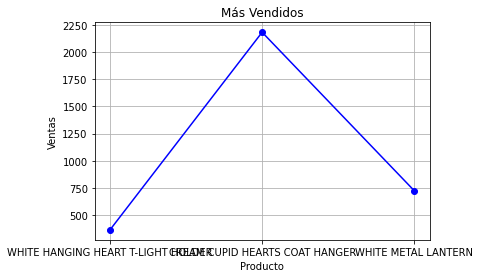

In [0]:
import matplotlib.pyplot as plt

def plot_line(df, x_col, y_col, xlabel='X', ylabel='Y', title='Gráfico de Línea', color='blue', linestyle='-', marker='o'):
    x = df.select(x_col).rdd.flatMap(lambda x: x).collect()
    y = df.select(y_col).rdd.flatMap(lambda x: x).collect()
    plt.plot(x, y, color=color, linestyle=linestyle, marker=marker)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.show()

# Uso de la función (suponiendo que df_mas_vendidos es un DataFrame de PySpark)
plot_line(df_mas_vendidos, "Description", "Ventas", xlabel='Producto', ylabel='Ventas', title='Más Vendidos')

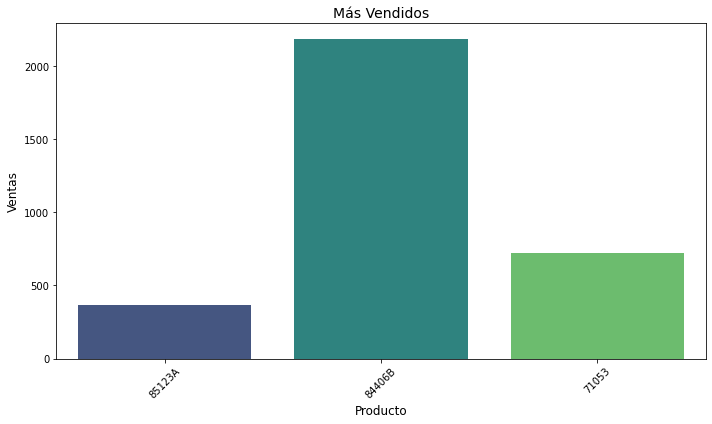

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_bar_seaborn(df, x_col, y_col, title="", x_label="", y_label="", figsize=(10, 6), palette="viridis"):
    x = df.select(x_col).rdd.flatMap(lambda x: x).collect()
    y = df.select(y_col).rdd.flatMap(lambda x: x).collect()
    plt.figure(figsize=figsize)
    sns.barplot(x=x, y=y, palette=palette)
    plt.title(title, fontsize=14)
    plt.xlabel(x_label, fontsize=12)
    plt.ylabel(y_label, fontsize=12)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Uso de la función (suponiendo que df_mas_vendidos es un DataFrame de PySpark)
plot_bar_seaborn(df_mas_vendidos, "StockCode", "Ventas", title='Más Vendidos', x_label='Producto', y_label='Ventas')